# 2 Sentiment Analysis
## 2.2 Movie Review Data

Let us first start by looking at the data provided with the exercise. We have positive and negative movie reviews labeled by human readers, all positive and negative reviews are in the ‘pos’ and ‘neg’ folders respectively. If you look in- side a sample file, you will see that these review messages have been ‘tokenized’, where all words are separated from punctuations.
There are approximately 1000 files in each category with files names starting with cv000, cv001, cv002 and so on. You will split the dataset into training set and testing set.

1. Write some code to load the data from text files.

In [1]:
from os import listdir
from os.path import join
from collections import Counter

In [2]:
# function load file text 

def load_data (filename):
    file = open(filename , "r")
    text = file.read() # read all 
    file.close()
    return text


In [3]:
load_data("review_polarity/txt_sentoken/neg/cv000_29416.txt")

'plot : two teen couples go to a church party , drink and then drive . \nthey get into an accident . \none of the guys dies , but his girlfriend continues to see him in her life , and has nightmares . \nwhat\'s the deal ? \nwatch the movie and " sorta " find out . . . \ncritique : a mind-fuck movie for the teen generation that touches on a very cool idea , but presents it in a very bad package . \nwhich is what makes this review an even harder one to write , since i generally applaud films which attempt to break the mold , mess with your head and such ( lost highway & memento ) , but there are good and bad ways of making all types of films , and these folks just didn\'t snag this one correctly . \nthey seem to have taken this pretty neat concept , but executed it terribly . \nso what are the problems with the movie ? \nwell , its main problem is that it\'s simply too jumbled . \nit starts off " normal " but then downshifts into this " fantasy " world in which you , as an audience membe

In [4]:
text_all = []

directory = "review_polarity/txt_sentoken/neg/"
for filename in listdir(directory): 
    if not filename.endswith(".txt"):
        continue
    path = directory + "/" + filename
    file = open(path)
    text = file.read()
    file.close()
#     print(text)
    text_all.append(text)
    
directory = "review_polarity/txt_sentoken/pos/"
for filename in listdir(directory): 
    if not filename.endswith(".txt"):
        continue
    path = directory + "/" + filename
    file = open(path)
    text = file.read()
    file.close()
     #print(text)
    text_all.append(text)

In [5]:
text_all

['a movie like mortal kombat : annihilation works ( and must be reviewed on ) multiple levels . \nfirst , there\'s the rampant usage of randian subtext that pervades the entire movie . \nbut occasionaly , almost as if making an ironic , self-depreciating remark , the movie tosses in clearly marxist imagery . \nno no . . . \njust kidding . \nhad you going there for a moment , didn\'t i ? \nin all seriousness however , and to be fair to the movie , it * is * necessary to provide two viewpoints : that of a movie watcher unfamiliar ( or only marginally familiar ) with the whole mortal kombat phenomenon , and that of a fan of the first movie and/or a fan of the games . \nthe first movie ( mortal kombat ( 1995 ) ) concerned itself with a martial arts tournament that would decide the fate of earth ( and it\'s 5 billion inhabitants ) . \nthe mortals won , and in theory this should have prevented the emperor shao khan from taking over the earth . \nunfortunately , shao khan was a poor loser , a

In [6]:
!pip install -U nltk

Requirement already up-to-date: nltk in c:\users\khing\anaconda3\lib\site-packages (3.6.2)


In [7]:
# import nltk
# nltk.download()

In [8]:
# Clean text data 
from nltk.corpus import stopwords
import string 
def clean_text(data):
    dataframe = data.split()
    table = str.maketrans("","",string.punctuation)
    dataframe = [w.translate(table) for w in dataframe]
    dataframe = [word for word in dataframe if word.isalpha()]

    stop_words = set(stopwords.words('english'))
    dataframe = [w for w in dataframe if not w in stop_words]

    dataframe = [word for word in dataframe if len(word) >1 ]
    return dataframe

In [9]:
def all_text (directory , vocab):
    load_line = []
    for filename in listdir(directory):
        if not filename.endswith(".txt"):
            continue
        path = directory + "/" + filename
        #add_text_to_vocab(path , vocab)
        load = add_text_to_vocab(path , vocab)
        load_line.append(load)
    return load_line

In [10]:
def add_text_to_vocab(filename , vocab):
    text = load_data(filename) # load test
    dataframe = clean_text(text)
    vocab.update(dataframe)
    # filter vocab 
    dataframe = [w for w in dataframe if w in vocab]
    return ''.join(dataframe)

In [11]:
# define vocab (pos , neg)
vocab = Counter()
vocab_pos = all_text("review_polarity/txt_sentoken/pos",vocab)
vocab_neg = all_text("review_polarity/txt_sentoken/neg",vocab)

In [12]:
len(vocab)

46557

In [13]:
vocab.most_common(20)

[('film', 8860),
 ('one', 5521),
 ('movie', 5440),
 ('like', 3553),
 ('even', 2555),
 ('good', 2320),
 ('time', 2283),
 ('story', 2118),
 ('films', 2102),
 ('would', 2042),
 ('much', 2024),
 ('also', 1965),
 ('characters', 1947),
 ('get', 1921),
 ('character', 1906),
 ('two', 1825),
 ('first', 1768),
 ('see', 1730),
 ('well', 1694),
 ('way', 1668)]

In [14]:
# Save Prepared data 
def save_text (path , filename):
    data = '\n'.join(path)
    file = open(filename,"w")
    file.write(data)
    file.close()

In [15]:
# หาอันที่มีโอกาสเกิดน้อยที่สุด 
min_occurrence = 5
tokens = [i for i,j in vocab.items() if j >= min_occurrence]

In [16]:
print(tokens , len(tokens))

['linda', 'fiorentino', 'disappeared', 'radar', 'deservedly', 'turn', 'cable', 'pic', 'last', 'seduction', 'cast', 'dogmas', 'lead', 'nothing', 'short', 'inexplicable', 'shes', 'still', 'fine', 'form', 'bethany', 'abortion', 'clinic', 'worker', 'whos', 'lost', 'faith', 'one', 'night', 'heaven', 'makes', 'fiery', 'entrance', 'bedroom', 'alan', 'rickman', 'voice', 'god', 'needs', 'help', 'must', 'stop', 'two', 'fallen', 'angels', 'entering', 'new', 'jersey', 'fate', 'universe', 'depends', 'would', 'missing', 'taken', 'human', 'somewhere', 'earth', 'never', 'heard', 'joined', 'road', 'trip', 'garden', 'state', 'prophets', 'jay', 'jason', 'mewes', 'silent', 'bob', 'kevin', 'smith', 'slacker', 'appeared', 'smiths', 'films', 'thus', 'far', 'point', 'rock', 'drops', 'naked', 'sky', 'rufus', 'black', 'thirteenth', 'apostle', 'offers', 'assistance', 'divine', 'stripper', 'serendipity', 'salma', 'hayek', 'wild', 'ride', 'theyre', 'pursuit', 'damon', 'affleck', 'probably', 'either', 'ever', 'bani

In [17]:
save_text(tokens,"data_vocab.txt")

In [18]:
# load vocab 
df_vocab = "data_vocab.txt"
df_vocab = load_data(df_vocab)
df_vocab = df_vocab.split()
df_vocab = set(df_vocab)
neg_data = all_text("review_polarity/txt_sentoken/neg/" , vocab)
pos_data = all_text("review_polarity/txt_sentoken/pos/" , vocab)

# save pos_data and neg_data 
save_text(neg_data , "data_neg.txt")
save_text(pos_data , "data_pos.txt")

## 2.3 TF-IDF
From a raw text review, you want to create a vector, whose elements indicate the number of each word in each document. The frequency of all words within the documents are the ‘features’ of this machine learning problem.

A popular method for transforming a text to a vector is called tf-idf, short for term frequencyinverse document frequency.

1. Conduct a research about tf-idf and explain how it works.
2. Scikit-learn provides a module for calculating this, this is called TfidfVec- torizer.
You can study how this function is used here:

`http://scikit-learn.org/stable/modules/generated/sklearn.feature_extraction.text.TfidfVectorizer.html`

Write code to transform your text to tf-idf vector.

## Conduct a research about tf-idf and explain how it works.

หลังการทำงานของ Tf-idf  คือ ใช้เปรียบเทียบความเหมือนกันของคำสอนคำ โดยวัดจาก tf และ idf
การวัด cosine ตรงๆระหว่างคำสองคำไม่ค่อยเหมาะ เนื่องจากข้อมูลจะเบ้หนักมาก แล้วก็แยกแยะกันได้ยาก 
เช่น คำพวก the , it , they พวกนี้จะมาทำการแยกยากเพราะไม่ค่อยให้ข้อมูลอะไร เราเลยจะใช้ Tf-idf เข้ามาช่วย

Tf : Term frequency คือการนับความถี่ของคำ (t) ในเอกสาร (d) จำนวนคำ 
                        tf = count(t,d)
หรือเราสามา take log ฐาน 10 เข้าไปเพื่อปรับสเกลไม่ให้เวอร์เกินไป 
                        tf = log10(count(t,d)+1)
                  (+1 เพราะว่าไม่ให้เกิดเคส log0)
idf : Inverse Document Frequency 
 df : document Frequency คือจะให้ weight เยอะๆสำหรับคำที่เจอไม่บ่อยในเอาสารมันมาจากแนวคิดว่าถ้าคำไหนเจอบ่อยๆใน เอกสารจะแปลว่ามันไม่สำคัญ
 df จะแตกต่างจาก collection frquency ตรงที่ถ้ากรอบ collection ของเราคือ document หลายๆชิ้นเวลานับ document frquency เราจะนับคำนั้นๆไปโผล่ใน
 document กี่ชิ้น ส่วน collection fequency จะนับว่าคำนั้นไปโผล่ใน collection (document ไหนก็ได้) กี่ครั้ง

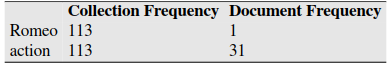

In [19]:
from IPython import display
display.Image("pic_tf-idf/0_nFyAU7l38Wo1dHhK.png")

เราจะใช้ Inverse Document Frequency ดทนเพื่อให้ตีความง่านกว่า Df มีสูตร คือ 
                        N/df
โดย N คือจำนวน document ใน collection ส่วน df คือจำนวน document ที่มีคำนั้นๆ 
นอกจากนี้ก็มีการ take log ฐาน10 เขาไปเช่นกัน เพื่อปรับสเกล
                        idf = log10(N/df) 

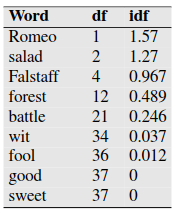

In [20]:
display.Image("pic_tf-idf/0_BM0SUOJBB4niQs0f.png")

ตามรูป N = 37 ทำให้ good กับ sweet ที่มี df = 37 คือ idf ออกมาได้ 0 
ยิ่งค่า idf สูงๆแปลว่าคำๆนั้นสำคัญมาก 
                            สรุป 
               tf-idf สามารถคำนวณตรงๆ ได้เลยคือ 
                       w = tf * idf

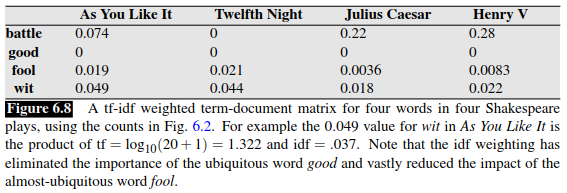

In [21]:
display.Image("pic_tf-idf/0_xpFqparOAIPNTZw9.png")

เราจะใช้ tf-idf เป็นค่ามาตรฐาน (baseline) สำหรับพิจรณา weighting ของ cooccurrence matrix

#### Refer: https://medium.com/@sirasith.petch/word-embedding-tf-idf-%E0%B9%81%E0%B8%A5%E0%B8%B0-word2vec-%E0%B8%84%E0%B8%B7%E0%B8%AD%E0%B8%AD%E0%B8%B0%E0%B9%84%E0%B8%A3-%E0%B9%81%E0%B8%A5%E0%B9%89%E0%B8%A7%E0%B8%A1%E0%B8%B1%E0%B8%99%E0%B8%A1%E0%B8%B5%E0%B8%9B%E0%B8%A3%E0%B8%B0%E0%B9%82%E0%B8%A2%E0%B8%8A%E0%B8%99%E0%B9%8C%E0%B8%A2%E0%B8%B1%E0%B8%87%E0%B9%84%E0%B8%87-9a6c593cf507

## Scikit-learn provides a module for calculating this, this is called TfidfVec- torizer. You can study how this function is used here

In [7]:
from sklearn.feature_extraction.text import TfidfVectorizer 

text_all = []
buff = 0 
directory = "review_polarity/txt_sentoken/neg/"
for filename in listdir(directory): 
    if not filename.endswith(".txt"):
        continue
    path = directory + "/" + filename
    file = open(path)
    text = file.read()
    file.close()
#     print(text)
    text_all.append(text)
    
directory = "review_polarity/txt_sentoken/pos/"
for filename in listdir(directory): 
    if not filename.endswith(".txt"):
        continue
    path = directory + "/" + filename
    file = open(path)
    text = file.read()
    file.close()
     #print(text)
    text_all.append(text)

In [4]:
print(text_all)

['a movie like mortal kombat : annihilation works ( and must be reviewed on ) multiple levels . \nfirst , there\'s the rampant usage of randian subtext that pervades the entire movie . \nbut occasionaly , almost as if making an ironic , self-depreciating remark , the movie tosses in clearly marxist imagery . \nno no . . . \njust kidding . \nhad you going there for a moment , didn\'t i ? \nin all seriousness however , and to be fair to the movie , it * is * necessary to provide two viewpoints : that of a movie watcher unfamiliar ( or only marginally familiar ) with the whole mortal kombat phenomenon , and that of a fan of the first movie and/or a fan of the games . \nthe first movie ( mortal kombat ( 1995 ) ) concerned itself with a martial arts tournament that would decide the fate of earth ( and it\'s 5 billion inhabitants ) . \nthe mortals won , and in theory this should have prevented the emperor shao khan from taking over the earth . \nunfortunately , shao khan was a poor loser , a

In [9]:
vectorizer = TfidfVectorizer()
X = vectorizer.fit_transform(text_all)

In [10]:
X.shape

(2000, 39659)

In [11]:
vectorizer.get_feature_names()

['00',
 '000',
 '0009f',
 '007',
 '00s',
 '03',
 '04',
 '05',
 '05425',
 '10',
 '100',
 '1000',
 '10000',
 '100m',
 '101',
 '102',
 '103',
 '104',
 '105',
 '106',
 '107',
 '108',
 '109',
 '10b',
 '10s',
 '10th',
 '11',
 '110',
 '111',
 '112',
 '113',
 '1138',
 '114',
 '115',
 '117',
 '118',
 '11th',
 '12',
 '121',
 '122',
 '123',
 '125',
 '126',
 '127',
 '1272',
 '128',
 '129',
 '1298',
 '12th',
 '13',
 '130',
 '1305',
 '131',
 '132',
 '133',
 '135',
 '137',
 '138',
 '139',
 '13th',
 '14',
 '140',
 '1400',
 '143',
 '144',
 '14th',
 '15',
 '150',
 '1500s',
 '150th',
 '151',
 '152',
 '1521',
 '153',
 '155',
 '1554',
 '157',
 '1583',
 '1590',
 '15th',
 '16',
 '160',
 '1600',
 '1600s',
 '161',
 '165',
 '167',
 '1692',
 '16mm',
 '16th',
 '16x9',
 '17',
 '170',
 '1700s',
 '1709',
 '172',
 '175',
 '1773',
 '1791',
 '1792',
 '1793',
 '1794',
 '1799',
 '17th',
 '18',
 '180',
 '1800',
 '1800s',
 '1812',
 '1830s',
 '1839',
 '1847',
 '1862',
 '1865',
 '1869',
 '1871',
 '1885',
 '1888',
 '189',
 '1

## 2.4 Classification

Use 4 different models to classify each movie into positive or negative category.

1. K-Nearestneighbormodel,using module `sklearn.neighbors.KNeighborsClassifier`
2. RandomForest, using module `sklearn.ensemble.RandomForestClassifier`
3. SVM, using module `sklearn.svm.SVC`
4. Neural network, using `sklearn.neural_network.MLPClassifier`

You may pick other models you would like to try. Just present results for at least 4 models.
Please provide your code for model fitting and cross validation. Calculate your classification accuracy, precision, and recall.

In [2]:
Data_dir = "review_polarity/txt_sentoken/"

In [3]:
import numpy as np 
import matplotlib.pyplot as plt 
from sklearn.datasets import load_files

In [4]:
data = load_files(Data_dir , encoding = "utf-8" , decode_error="replace")

In [5]:
data

{'data': ["arnold schwarzenegger has been an icon for action enthusiasts , since the late 80's , but lately his films have been very sloppy and the one-liners are getting worse . \nit's hard seeing arnold as mr . freeze in batman and robin , especially when he says tons of ice jokes , but hey he got 15 million , what's it matter to him ? \nonce again arnold has signed to do another expensive blockbuster , that can't compare with the likes of the terminator series , true lies and even eraser . \nin this so called dark thriller , the devil ( gabriel byrne ) has come upon earth , to impregnate a woman ( robin tunney ) which happens every 1000 years , and basically destroy the world , but apparently god has chosen one man , and that one man is jericho cane ( arnold himself ) . \nwith the help of a trusty sidekick ( kevin pollack ) , they will stop at nothing to let the devil take over the world ! \nparts of this are actually so absurd , that they would fit right in with dogma . \nyes , the

In [53]:
# Calculate count of each category
labels , counts = np.unique(data.target , return_counts = True)

In [54]:
labels_str = np.array(data.target_names)[labels]
labels_str = dict(zip(labels_str , counts))

In [55]:
labels_str

{'neg': 1000, 'pos': 1000}

In [56]:
data.data

["arnold schwarzenegger has been an icon for action enthusiasts , since the late 80's , but lately his films have been very sloppy and the one-liners are getting worse . \nit's hard seeing arnold as mr . freeze in batman and robin , especially when he says tons of ice jokes , but hey he got 15 million , what's it matter to him ? \nonce again arnold has signed to do another expensive blockbuster , that can't compare with the likes of the terminator series , true lies and even eraser . \nin this so called dark thriller , the devil ( gabriel byrne ) has come upon earth , to impregnate a woman ( robin tunney ) which happens every 1000 years , and basically destroy the world , but apparently god has chosen one man , and that one man is jericho cane ( arnold himself ) . \nwith the help of a trusty sidekick ( kevin pollack ) , they will stop at nothing to let the devil take over the world ! \nparts of this are actually so absurd , that they would fit right in with dogma . \nyes , the film is 

In [6]:
data.target

array([0, 1, 1, ..., 1, 0, 0])

In [7]:
from sklearn.feature_extraction.text import TfidfVectorizer ,TfidfTransformer
vectorizer = TfidfVectorizer(stop_words="english"  , decode_error= "ignore").fit(data.data)
tf_idf = TfidfTransformer()
vector = tf_idf.fit_transform(vectorizer.fit_transform(data.data)) # x
print(vector.shape)

(2000, 39354)


In [8]:
# Data prepararion 
from sklearn.model_selection import train_test_split
X_train , x_test , y_train , y_test = train_test_split(vector , data.target , test_size = 0.2,random_state=42 )

In [9]:
X_train.shape

(1600, 39354)

In [10]:
y_train.shape

(1600,)

In [11]:
x_test.shape

(400, 39354)

# Build model 
1.K-Nearestneighbor

2.RandomForest

3.SVM

4.Neural network

Just present results for at least 4 models. Please provide your code for model fitting and cross validation.

Calculate your classification accuracy, precision, and recall.

# K-Nearestneighbor

In [167]:
from sklearn.model_selection import cross_val_predict , cross_val_score
from sklearn.metrics import  accuracy_score , precision_score , recall_score 
from sklearn.neighbors import KNeighborsClassifier
np.random.seed(42)

neigh = KNeighborsClassifier(n_neighbors=5)
model = neigh.fit(X_train,y_train)

y_pred = model.predict(x_test)

# cross validation 
print(f"model (KNN) accuracy  : {accuracy_score(y_test,y_pred):.2f}")
print(f"model (KNN) precision : {precision_score(y_test, y_pred):.2f}")
print(f"model (KNN) recall    : {recall_score(y_test, y_pred):.2f}")

model (KNN) accuracy  : 0.66
model (KNN) precision : 0.67
model (KNN) recall    : 0.68


# RandomForest

In [131]:
from sklearn.ensemble import RandomForestClassifier

np.random.seed(42)

clf = RandomForestClassifier(n_estimators=100, criterion="gini")
model = clf.fit(X_train ,y_train)

y_pred = model.predict(x_test)
print(f"model (RandomForest) accuracy  : {accuracy_score(y_test,y_pred):.2f}")
print(f"model (RandomForest) precision : {precision_score(y_test, y_pred):.2f}")
print(f"model (RandomForest) recall    : {recall_score(y_test, y_pred):.2f}")

model (RandomForest) accuracy  : 0.80
model (RandomForest) precision : 0.85
model (RandomForest) recall    : 0.76


# SVM

In [152]:
from sklearn.svm import SVC
np.random.seed(42)
svm = SVC(C=1 , kernel="sigmoid" , degree = 3)
model = svm.fit(X_train , y_train)
y_pred = model.predict(x_test)

print(f"model (SVM) accuracy  : {accuracy_score(y_test,y_pred):.2f}")
print(f"model (SVM) precision : {precision_score(y_test , y_pred):.2f}")
print(f"model (SVM) recall    : {recall_score(y_test, y_pred):.2f}")

model (SVM) accuracy  : 0.80
model (SVM) precision : 0.82
model (SVM) recall    : 0.79


# Neural network

In [149]:
from sklearn.neural_network import MLPClassifier
np.random.seed(42)
Nn = MLPClassifier(hidden_layer_sizes=100 , activation='relu' 
                   ,alpha= 0.0001 , learning_rate='constant')
# y_pred_Nn = cross_val_predict(Nn , vector , y , cv = 5)
model = Nn.fit(X_train , y_train)
y_pred = model.predict(x_test)
print(f"model (Neural network) accuracy  : {accuracy_score(y_test,y_pred):.2f}")
print(f"model (Neural network) precision : {precision_score(y_test , y_pred):.2f}")
print(f"model (Neural network) recall    : {recall_score(y_test ,y_pred):.2f}")

model (Neural network) accuracy  : 0.81
model (Neural network) precision : 0.82
model (Neural network) recall    : 0.80


In [217]:
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC
from sklearn.metrics import classification_report
y = data.target
KNN = KNeighborsClassifier(n_neighbors=5)
RFC = RandomForestClassifier(n_estimators=100, criterion="gini")
SVM = SVC(C=1 , kernel="sigmoid" , degree = 3)
MLP = MLPClassifier(hidden_layer_sizes=100 , activation='relu' 
                   ,alpha= 0.0001 , learning_rate='constant')
names_model = ["KNeighbors" , "RandomForest" , "SCV" , "Neural Network"]
list_model = [KNN,
              RFC,
              SVM,
              MLP]
for i , model in enumerate(list_model):
    y_pred = cross_val_predict(model , vector , y , cv =5)
    print(f"Name model : {names_model[i]}")
    print("Classification report")
    print(classification_report (y , y_pred , target_names = ['Neg' , 'Pos']))

Name model : KNeighbors
Classification report
              precision    recall  f1-score   support

         Neg       0.66      0.60      0.63      1000
         Pos       0.64      0.69      0.67      1000

    accuracy                           0.65      2000
   macro avg       0.65      0.65      0.65      2000
weighted avg       0.65      0.65      0.65      2000

Name model : RandomForest
Classification report
              precision    recall  f1-score   support

         Neg       0.76      0.84      0.80      1000
         Pos       0.82      0.74      0.78      1000

    accuracy                           0.79      2000
   macro avg       0.79      0.79      0.79      2000
weighted avg       0.79      0.79      0.79      2000

Name model : SCV
Classification report
              precision    recall  f1-score   support

         Neg       0.81      0.80      0.81      1000
         Pos       0.80      0.81      0.81      1000

    accuracy                           0.81      

## 2.5 Model Tuning

Can you try to beat the simple model you created above? Here are some things you may try:

* When creating TfidfVectorizer object, you may tweak sublinear_tf parameter which use the tf with logarithmic scale instead of the usual tf.
* You may also exclude words that are too frequent or too rare, by adjusting max_df and min_df.
* Adjusting parameters available in the model, like neural network structure or number of trees in the forest.

Design at least 3 experiments using these techniques. Show your experimental results.


In [12]:
from sklearn.feature_extraction.text import TfidfVectorizer ,TfidfTransformer

vectorizer = TfidfVectorizer(sublinear_tf=True,stop_words="english" ,max_df = 1 , min_df = 1).fit(data.data)
tf_idf = TfidfTransformer()
vector = tf_idf.fit_transform(vectorizer.fit_transform(data.data)) # x
print(vector.shape)

(2000, 15570)


In [13]:
X_var, x_buff , y_var , y_buff = train_test_split(x_test , y_test , test_size = 0.3 )

Text(0, 0.5, 'loss')

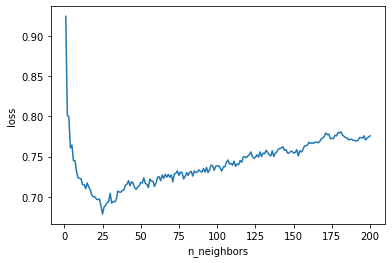

In [253]:
# Tune KNN 
log_data = {'n_neighbors' : [],
            'loss' : []}
for i in range (1,201):
    KNN = KNeighborsClassifier(n_neighbors=i)
    model = KNN.fit(X_train , y_train)
    y_pred = model.predict(X_var)
    accu = accuracy_score(y_var , y_pred)
    log_data['n_neighbors'].append(i)
    log_data['loss'].append(accu)
plt.plot(log_data['n_neighbors'] ,log_data['loss'])
plt.xlabel('n_neighbors')
plt.ylabel('loss')

In [260]:
KNN = KNeighborsClassifier(n_neighbors= 175)
model = KNN.fit(X_train , y_train)
y_pred = model.predict(x_test)
print(f"Confusion matrix : \
      \n{confusion_matrix(y_test , y_pred)}")
print(f"Classification Report : \
      \n{classification_report (y_test , y_pred , target_names = ['Neg' , 'Pos']) }")

Confusion matrix :       
[[155  44]
 [ 45 156]]
Classification Report :       
              precision    recall  f1-score   support

         Neg       0.78      0.78      0.78       199
         Pos       0.78      0.78      0.78       201

    accuracy                           0.78       400
   macro avg       0.78      0.78      0.78       400
weighted avg       0.78      0.78      0.78       400



Text(0, 0.5, 'loss')

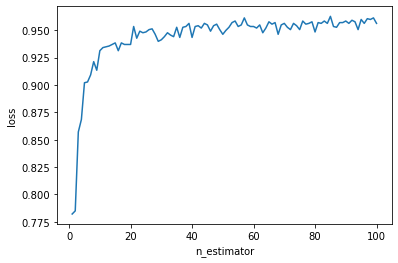

In [233]:
# Tune Random Forest 
log_data = {'n_estimator' : [],
            'loss' : []}

for i in range(1,101):
    model = RandomForestClassifier(n_estimators=i).fit(X_train , y_train)
    y_pred = model.predict(X_var)
    accu = accuracy_score(y_var , y_pred)
    log_data['n_estimator'].append(i)
    log_data['loss'].append(accu)
plt.plot(log_data['n_estimator'] ,log_data['loss'])
plt.xlabel('n_estimator')
plt.ylabel('loss')

In [235]:
from sklearn.metrics import confusion_matrix
RFC = RandomForestClassifier(n_estimators=85, criterion="gini")
model = RFC.fit(X_train , y_train)
y_pred = model.predict(x_test)
print(f"Confusion matrix : \
      \n{confusion_matrix(y_test , y_pred)}")
print(f"Classification Report : \
      \n{classification_report (y_test , y_pred , target_names = ['Neg' , 'Pos']) }")

Confusion matrix :       
[[168  31]
 [ 56 145]]
Classification Report :       
              precision    recall  f1-score   support

         Neg       0.75      0.84      0.79       199
         Pos       0.82      0.72      0.77       201

    accuracy                           0.78       400
   macro avg       0.79      0.78      0.78       400
weighted avg       0.79      0.78      0.78       400



In [15]:
from sklearn.model_selection import GridSearchCV
from sklearn.neural_network import MLPClassifier
Nn_tuning = MLPClassifier(max_iter=1000 , early_stopping=True , n_iter_no_change=20 )
hidden_layer_sizes = [(70,55,70),(100)]
activation = ["identity" , "logistic" , "tanh" ,"relu"]
solver = ["lbfgs" , "sgd" ,"adam"]
alpha = [0.001 , 0.005 ]
learning_rate = ['constant' , 'invscaling' ,'adaptive']

param_grid = dict(hidden_layer_sizes= hidden_layer_sizes , activation=activation,
                  solver=solver , alpha=alpha , learning_rate = learning_rate)
grid = GridSearchCV(Nn_tuning , param_grid ,n_jobs= -1 , cv=10 )
print(param_grid)
grid.fit(X_train , y_train)

{'hidden_layer_sizes': [(70, 55, 70), 100], 'activation': ['identity', 'logistic', 'tanh', 'relu'], 'solver': ['lbfgs', 'sgd', 'adam'], 'alpha': [0.001, 0.005], 'learning_rate': ['constant', 'invscaling', 'adaptive']}


GridSearchCV(cv=10,
             estimator=MLPClassifier(early_stopping=True, max_iter=1000,
                                     n_iter_no_change=20),
             n_jobs=-1,
             param_grid={'activation': ['identity', 'logistic', 'tanh', 'relu'],
                         'alpha': [0.001, 0.005],
                         'hidden_layer_sizes': [(70, 55, 70), 100],
                         'learning_rate': ['constant', 'invscaling',
                                           'adaptive'],
                         'solver': ['lbfgs', 'sgd', 'adam']})

In [16]:
print(f"Good parameters : {grid.best_params_}")

Good parameters : {'activation': 'relu', 'alpha': 0.005, 'hidden_layer_sizes': (70, 55, 70), 'learning_rate': 'invscaling', 'solver': 'adam'}


# 3 Text Clustering
We have heard about Google News clustering. In this exercise, we are going to implement it with Python.

## 3.1 Data Preprocessing
Let’s switch up and use another dataset called 20newsgroup data, which is a collection of approximately 20,000 newsgroup documents, partitioned (nearly) evenly across 20 different newsgroups. The data is collected from a university’s mailing list, where students exchange opinions in everything from motorcycles to middle east politics.

1. Import data using sklearn.datasets.fetch_20newsgroups 
2. Transform data to vector with TfidfVectorizer

In [1]:
from sklearn.datasets import fetch_20newsgroups

newsgroups_train = fetch_20newsgroups(subset='train')

In [14]:
data = newsgroups_train.data

In [2]:
labels = newsgroups_train.target

In [3]:
labels

array([7, 4, 4, ..., 3, 1, 8])

In [5]:
import numpy as np
true_k = np.unique(labels).shape[0]
true_k

20

In [6]:
newsgroups_train.filenames.shape , newsgroups_train.target.shape

((11314,), (11314,))

In [7]:
from pprint import pprint
pprint(list(newsgroups_train.target_names))

['alt.atheism',
 'comp.graphics',
 'comp.os.ms-windows.misc',
 'comp.sys.ibm.pc.hardware',
 'comp.sys.mac.hardware',
 'comp.windows.x',
 'misc.forsale',
 'rec.autos',
 'rec.motorcycles',
 'rec.sport.baseball',
 'rec.sport.hockey',
 'sci.crypt',
 'sci.electronics',
 'sci.med',
 'sci.space',
 'soc.religion.christian',
 'talk.politics.guns',
 'talk.politics.mideast',
 'talk.politics.misc',
 'talk.religion.misc']


In [8]:
from sklearn.feature_extraction.text import TfidfVectorizer,CountVectorizer,TfidfTransformer
from sklearn.pipeline import Pipeline
categories = list(newsgroups_train.target_names)
newsgroups_train = fetch_20newsgroups(subset='train' , categories=categories)

vectorizer = TfidfVectorizer( stop_words='english' , analyzer = 'word')
X = vectorizer.fit_transform(newsgroups_train.data)

In [9]:
idf = vectorizer.idf_
print(dict(zip(vectorizer.get_feature_names(),idf)))

{'00': 4.2253700454994085, '000': 4.305969205248958, '0000': 8.359202379228627, '00000': 8.76466748733679, '000000': 10.150961848456683, '00000000': 9.745496740348518, '0000000004': 9.052349559788572, '0000000005': 9.457814667896738, '00000000b': 10.150961848456683, '00000001': 10.150961848456683, '00000001b': 10.150961848456683, '0000000667': 10.150961848456683, '00000010': 10.150961848456683, '00000010b': 10.150961848456683, '00000011': 10.150961848456683, '00000011b': 10.150961848456683, '0000001200': 8.541523936022582, '00000074': 10.150961848456683, '00000093': 10.150961848456683, '000000e5': 10.150961848456683, '00000100': 10.150961848456683, '00000100b': 10.150961848456683, '00000101': 10.150961848456683, '00000101b': 10.150961848456683, '00000110': 10.150961848456683, '00000110b': 10.150961848456683, '00000111': 10.150961848456683, '00000111b': 10.150961848456683, '000003': 10.150961848456683, '00000315': 10.150961848456683, '000005102000': 9.457814667896738, '00000510200001': 

In [10]:
X.shape

(18846, 173451)

## 3.2 Clustering
We are going to use the simplest clustering model, k-means clustering, to do this task. Our hope is that this simple algorithm will result in meaningful news categories, without using labels.

1. Fit K-Means clustering model to the text vector. What is the value of K you should pick? Why?
2. Use Silhouette score to evaluate your clusters. Try to evaluate the model for different values of k to see which k fits best for the dataset.

In [11]:
from sklearn.cluster import KMeans
from sklearn import metrics
import matplotlib.pyplot as plt
import numpy as np 
np.random.seed(42)
score = []
for i in range(2 , 21, 1):
    Km = KMeans(n_clusters=i )
    %time Km.fit(X)
    silhouette_avg = metrics.silhouette_score(X ,Km.labels_)
    score.append(silhouette_avg)
    print("For n_clusters =", i,
          "The average silhouette_score is :", silhouette_avg)
    
# print(f"V-measure  : {metrics.v_measure_score(labels , Km.labels_):.2f} ")
# print(f"Silhouette : {metrics.silhouette_score(X ,Km.labels_ , sample_size=1000):.4f}")


Wall time: 22.4 s
For n_clusters = 2 The average silhouette_score is : 0.0015261972309054347
Wall time: 45 s
For n_clusters = 3 The average silhouette_score is : 0.0017983348908773146
Wall time: 1min 6s
For n_clusters = 4 The average silhouette_score is : 0.0018570520623438999
Wall time: 59.3 s
For n_clusters = 5 The average silhouette_score is : 0.0022122953712079728
Wall time: 1min 10s
For n_clusters = 6 The average silhouette_score is : 0.0026199475624456843
Wall time: 1min 27s
For n_clusters = 7 The average silhouette_score is : 0.0029534257434974767
Wall time: 1min 44s
For n_clusters = 8 The average silhouette_score is : 0.003022154407938752
Wall time: 1min 48s
For n_clusters = 9 The average silhouette_score is : 0.0031377974831349412
Wall time: 2min
For n_clusters = 10 The average silhouette_score is : 0.0035428899816962373
Wall time: 2min 2s
For n_clusters = 11 The average silhouette_score is : 0.0037668693967347396
Wall time: 2min 32s
For n_clusters = 12 The average silhouette_

In [12]:
k = score.index(max(score)) +2 
k

20

# 3.3 Topic Terms
We want to explore each cluster to understand what news articles are in the cluster, what terms are associated with the cluster. This will require a bit of hacking.
1. Use TfidfVectorizer.get feature names to extract words associated with each dimension of the text vector.
2. Extract cluster’s centroids using kmeans.cluster centers .
3. For each centroid, print the top 15 words that have the highest frequency.

In [272]:
vectorizer.get_feature_names()

['00',
 '000',
 '0000',
 '00000',
 '000000',
 '00000000',
 '0000000004',
 '0000000005',
 '00000000b',
 '00000001',
 '00000001b',
 '0000000667',
 '00000010',
 '00000010b',
 '00000011',
 '00000011b',
 '0000001200',
 '00000074',
 '00000093',
 '000000e5',
 '00000100',
 '00000100b',
 '00000101',
 '00000101b',
 '00000110',
 '00000110b',
 '00000111',
 '00000111b',
 '00000315',
 '000005102000',
 '00000510200001',
 '000007',
 '00000ee5',
 '00001000',
 '00001000b',
 '00001001',
 '00001001b',
 '00001010',
 '00001010b',
 '00001011',
 '00001011b',
 '000010af',
 '00001100',
 '00001100b',
 '00001101',
 '00001101b',
 '00001110',
 '00001110b',
 '00001111',
 '00001111b',
 '000021',
 '000042',
 '000062david42',
 '000094',
 '0000vec',
 '0001',
 '00010000',
 '00010000b',
 '00010001',
 '00010001b',
 '00010010',
 '00010010b',
 '00010011',
 '00010011b',
 '000100255pixel',
 '00010100',
 '00010100b',
 '00010101',
 '00010101b',
 '00010110',
 '00010110b',
 '00010111',
 '00010111b',
 '00011000',
 '00011000b',
 '00

In [13]:
# ค่า k จริงๆ ที่เราจะใช้เราจะต้องดูตามความเหมาะสม เดี๋ยวจะวน loop เพื่อหาค่า k ที่ดีที่สุด 
centroids = Km.cluster_centers_.argsort()[:,::-1]
terms = vectorizer.get_feature_names() 

for i in range(k):
    print(f"Cluster : {i}")
    for j in centroids[i,:15]:
        print(f'{terms[j]}')
    print("\n")

Cluster : 0
uk
ac
mathew
mantis
demon
university
writes
subject
lines
organization
cam
com
article
dcs
edu


Cluster : 1
cs
edu
colorado
university
writes
article
nyx
organization
posting
subject
nntp
host
lines
berkeley
utexas


Cluster : 2
game
team
games
hockey
edu
ca
year
players
season
play
win
baseball
espn
nhl
player


Cluster : 3
stratus
sw
cdt
com
rocket
vos
tavares
investors
packet
computer
believe
speak
special
today
write


Cluster : 4
nasa
space
gov
access
digex
pat
jpl
shuttle
alaska
edu
net
com
mission
orbit
prb


Cluster : 5
people
edu
gun
com
don
government
writes
think
fbi
just
article
like
right
batf
cramer


Cluster : 6
com
car
writes
article
hp
netcom
subject
organization
lines
edu
bike
sun
ca
like
posting


Cluster : 7
henry
toronto
zoo
spencer
zoology
edu
utzoo
kipling
launch
svr3
resembles
work
svr4
collision
dunn


Cluster : 8
armenian
turkish
armenians
livesey
sgi
armenia
solntze
wpd
serdar
argic
jon
turks
turkey
genocide
soviet


Cluster : 9
scsi
drive
ide
co

In [17]:
data[350]

'From: lhenso@unf6.cis.unf.edu (Larry Henson)\nSubject: IBM link to Imagewriter -- HELP!! \nOrganization: University of North Florida, Jacksonville\nLines: 10\n\n\tHello, I am trying to hook an Apple Imagewriter to my IBM Clone.\nI seem to have a problem configuring my lpt port to accept this.  How can\nyou adjust baud, parity, etc. to fit the system?  I tried MODE, but it did\nnot work.  If anyone can help, post of e-mail.  Thanx.\n\n-- \n\t"Abort, Retry, FORMAT?!?!?\n\tDoctor, give me the chainsaw...\n\tTrust me! I\'m a scientist!"\n\t\t\t\tLarry Henson\n'

In [22]:
test_data = vectorizer.transform([data[400]])
Km = KMeans(n_clusters=20)
model = Km.fit(X)
clu = model.predict(test_data)[0]
clu

5